<a href="https://colab.research.google.com/github/regev121/Colab-Projects/blob/main/game_review_project_finished.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Imports

In [ ]:
!pip install steamreviews
!pip install -U sentence-transformers


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 1.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 26.3 MB/s eta 0:00:00
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125923 sha256=40a7c9488c05faa31e6e5c63fdccb63fac39ad8e44c74818b7dc09032c90b3f2
  Stored in directory: /root/.cache/pip/wheels/62/f2/10/1e606fd5f02395388f74e7462910fe851042f97238cbbd902f
Successfully built sentence-transformers


In [ ]:
import steamreviews
import pandas as pd
import datetime as dt
import numpy as np
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
from sentence_transformers import SentenceTransformer, util
from nltk.tokenize import sent_tokenize
import torch
import nltk
from scipy import stats
from nltk.util import ngrams
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from tensorflow.keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
import re
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold, cross_val_score
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
from scipy.spatial.distance import cosine

nltk.download('vader_lexicon')
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)


# DF

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/reviews.csv")

<ipython-input-6-6bdc0c411b8e>:1: DtypeWarning: Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("/content/drive/MyDrive/reviews.csv")


In [ ]:
recommended_column = df.pop('Recommended')

df.insert(2, 'Recommended', recommended_column)


# EDA

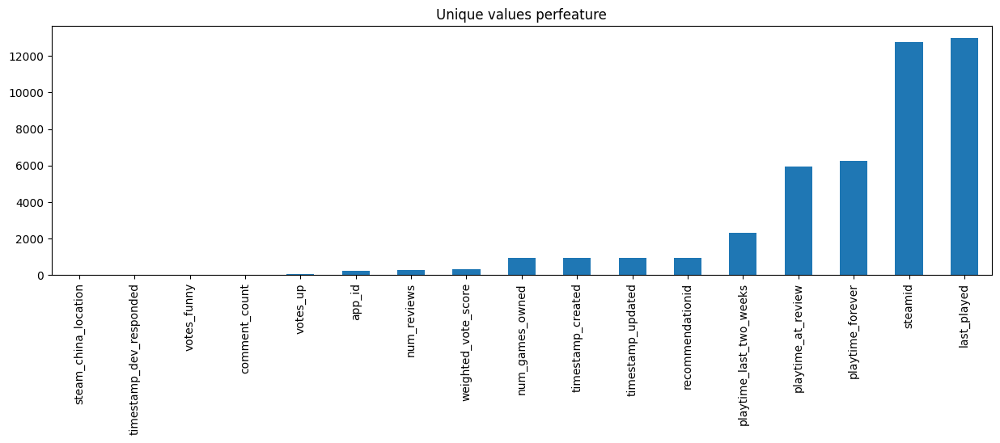

In [ ]:

unique_values = df.select_dtypes(include="number").nunique().sort_values()
unique_values.plot.bar(figsize=(15, 4),title="Unique values perfeature");

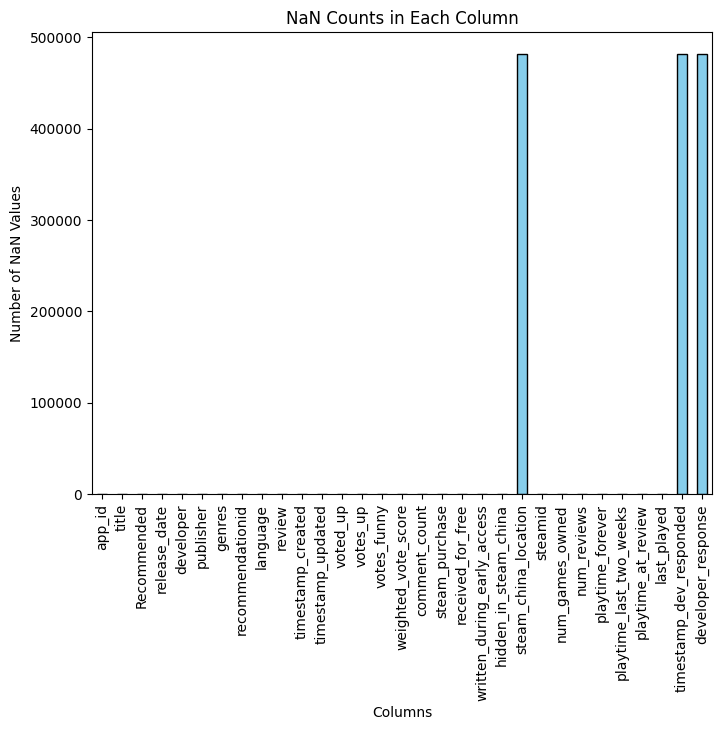

In [ ]:
nan_counts = df.isnull().sum()

plt.figure(figsize=(8, 6))
nan_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title("NaN Counts in Each Column")
plt.xlabel("Columns")
plt.ylabel("Number of NaN Values")
plt.xticks(rotation=90)
plt.show()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 481571 entries, 0 to 481570
Data columns (total 31 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   app_id                       481571 non-null  int64  
 1   title                        481571 non-null  object 
 2   Recommended                  481571 non-null  bool   
 3   release_date                 481571 non-null  object 
 4   developer                    481571 non-null  object 
 5   publisher                    481571 non-null  object 
 6   genres                       481571 non-null  object 
 7   recommendationid             481571 non-null  int64  
 8   language                     481571 non-null  object 
 9   review                       481571 non-null  object 
 10  timestamp_created            481571 non-null  int64  
 11  timestamp_updated            481571 non-null  int64  
 12  voted_up                     481571 non-null  bool   
 13 

In [ ]:
df.isnull().sum().sum()

1444151

In [ ]:
df.isna().sum().sum()

1444151

In [ ]:
print(type(df['release_date'][0]))
print(df['app_id'].unique())
print(df['votes_up'].unique())
print(df['title'].unique())


<class 'str'>
[ 682140  427190  718560  464920  290300  357190  620590  318600  673610
  384190  426050  372360   21000  567080  249050  349300  281610  502520
  413410  310060  586140  225840  385800  346940  577080  262850  977400
  551170  251110  299360   18420  231740   32400  895570  248570  714800
  315660    6900  314660  497850  604240   96000   42670  824720  633360
  242860  577970  448370  457140  368050  363920  388800  527230  205950
  698330    4890  629000  218230  701160  237630  683320  236110  792410
  654220  359100  951240  601150  214770  319510  350500  307690  676820
  356050  386340   24720  850060  674020  430960  758930  712730  523780
   35300   55150  761620    8930  559650  365960      80  951440    8080
  205230  341910  252870  911400  252130  365450   13600  313120  698540
    6910   57690  570940  746940      40  319740  227860  614570   65930
  815370   92300  915600  391720   80330  654990  209190  262830   15500
  206440  629730  215080  376210  855

In [ ]:
df['votes_up'].unique()

array([  0,   1,   6,   5,   2,   3,  64,  28,   4,  12,  25,  10,   8,
        68, 246,  15,   7,  49,   9,  24,  22, 123,  52,  77,  11,  80,
        26,  13,  62,  18,  16,  31,  70,  14, 224,  19,  37])

In [ ]:
type(df['voted_up'][0])

numpy.bool_

In [ ]:
df = df[(df['votes_up'] > 1) & (df['votes_up'] < 60)]
df.reset_index(drop=True, inplace=True)


In [ ]:
df.describe(exclude=["number","datetime"])

,title,Recommended,release_date,developer,publisher,genres,language,review,voted_up,steam_purchase,received_for_free,written_during_early_access,hidden_in_steam_china,developer_response
count,105219,105219,105219,105219,105219,105219,105219,105219,105219,105219,105219,105219,105219,69
unique,94,2,90,88,79,52,1,246,2,2,2,2,1,1
top,The Isle,False,2015-12-01,Afterthought LLC,Afterthought LLC,Action;Adventure;Indie;Massively Multiplayer;Simulation;Early Access,english,"A lot of people might think negatively on this game, remembering it only through the internet's obsession with it, and the many sequels to follow that miss bits of what made the original so special and terrifying on its release in 2014, but I think it still holds up as the best game in the FNAF franchise - a very delicate balance of simple, but perfectly chosen gameplay components, and a uniquely-eerie visual style that still stands out today. It's no masterpiece, but it's only like an hour long, and for a short, experimental horror game, I think Five Nights at Freddy's offers all you could really want from it.",True,True,False,False,True,"Hello, \n\nPlease note that the game officially supports only Oculus Rift and HTC Vive VR headsets. Vive Pro and Rift S should work.\n\nRegarding the Index, Quest, Cosmos or any WMR-compatible devices - for now we do not have these headsets by our hands, and do not have plans to supported them in near future. Sorry.\n\nAlso please take into account these advices if you use VR with City Car Driving:\n\n- Update your VR headset software & drivers. \n- Update your video card driver to the latest version.\n- Make sure you connect your VR headset before(!) starting the game. \n- Do not launch/use SteamVR. If SteamVR is already running – close it before launching the game. Then just run the game in a usual way and select the VR output in the in-game settings menu.\n- VR activates only after the driving session start (it does not work in the main menu).\n- If you feel you still need to make lower motion sickness effects you can try disabling some of the camera inertion effects as described here - https://steamcommunity.com/app/493490/discussions/0/3277925755433585773/\n"
freq,31606,75590,31606,31606,31606,31606,105219,2682,61363,85404,103338,72827,105219,69


In [ ]:
df.drop_duplicates(subset='recommendationid', keep='first', inplace=True)

In [ ]:
df['timestamp_created'] = pd.to_datetime(df['timestamp_created'], unit="s")
df['timestamp_updated'] = pd.to_datetime(df['timestamp_updated'], unit="s")
df['release_date'] = pd.to_datetime(df['release_date'])


In [ ]:
df.drop(['steam_china_location', 'hidden_in_steam_china'], axis=1, inplace=True)
df.drop(['developer_response', 'timestamp_dev_responded'], axis=1, inplace=True)
df.drop(['written_during_early_access'], axis=1, inplace=True)
#מוחקים את סטים-צ'יינה-לוקיישן מכיוון שאין נתונים בכלל ובכללי מוחקים את שניהם בגלל שאנחנו לא יודעים איך הגיעו לדאטה סט מכיוון שהגיעו דרך האייפיעי של סטים אבל לא רשומים בדוקומנטציה ההסבר למושגים זה משחקים שקיימים רק בסין ומוסתרים בסין

In [ ]:
df.columns

Index(['app_id', 'title', 'Recommended', 'release_date', 'developer',
       'publisher', 'genres', 'recommendationid', 'language', 'review',
       'timestamp_created', 'timestamp_updated', 'voted_up', 'votes_up',
       'votes_funny', 'weighted_vote_score', 'comment_count', 'steam_purchase',
       'received_for_free', 'steamid', 'num_games_owned', 'num_reviews',
       'playtime_forever', 'playtime_last_two_weeks', 'playtime_at_review',
       'last_played'],
      dtype='object')

In [ ]:
genres_df = df['genres'].str.get_dummies(sep=';')

df = pd.concat([df, genres_df], axis=1)

df.drop('genres', axis=1, inplace=True)

In [ ]:
genres_df

,Action,Adventure,Casual,Early Access,Free to Play,Indie,Massively Multiplayer,Nudity,RPG,Racing,Sexual Content,Simulation,Sports,Strategy
0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
39,1,1,0,0,0,0,0,0,0,0,0,0,0,0
78,1,1,0,0,0,0,0,0,0,0,0,0,0,0
117,0,0,0,0,0,0,0,0,0,0,0,0,0,1
131,0,0,0,0,0,0,0,0,0,0,0,1,0,1
182,1,1,0,0,0,1,0,0,1,0,0,1,0,0
188,1,1,0,0,0,1,0,0,1,0,0,1,0,0
194,1,0,0,0,0,0,0,0,0,0,0,0,0,0
274,0,0,0,1,0,1,0,0,0,0,0,1,0,1
304,1,1,1,0,0,1,0,0,0,0,0,1,0,0


In [ ]:
df

app_id                                              title  \
0       427190                                       DEAD RISING®   
39      427190                                       DEAD RISING®   
78      427190                                       DEAD RISING®   
117     718560                            Scythe: Digital Edition   
131     464920                                     Surviving Mars   
182     290300                                       Rebel Galaxy   
188     290300                                       Rebel Galaxy   
194     357190                       ULTIMATE MARVEL VS. CAPCOM 3   
274     673610                                        Airport CEO   
304     384190                                               ABZU   
355     384190                                               ABZU   
406      21000                       LEGO® Batman™: The Videogame   
466      21000                       LEGO® Batman™: The Videogame   
526     249050                            Dungeon of the Endless™   
557     249050                            Dungeon of the Endless™   
588     349300               Littlewitch Romanesque: Editio Regia   
590     349300               Littlewitch Romanesque: Editio Regia   
592     281610                       Homeworld: Deserts of Kharak   
614     281610                       Homeworld: Deserts of Kharak   
636     586140                            BlazBlue Centralfiction   
705     225840                                         Sven Co-op   
879     385800                                    NEKOPARA Vol. 0   
897     346940            Shadowrun: Hong Kong - Extended Edition   
903     977400         Cell to Singularity - Evolution Never Ends   
1017    977400         Cell to Singularity - Evolution Never Ends   
1131    251110                                              INFRA   
1159     32400                           STAR WARS™ - Dark Forces   
1169      6900                                Hitman: Codename 47   
1184    314660                            Oddworld: New 'n' Tasty   
1192     96000                                The Tiny Bang Story   
1197    824720                                 Pure Rock Crawling   
1198    242860                                             Verdun   
1231    457140                                Oxygen Not Included   
1848    457140                                Oxygen Not Included   
2465    457140                                Oxygen Not Included   
3082    457140                                Oxygen Not Included   
3699    457140                                Oxygen Not Included   
4316    527230                                       For The King   
4441    527230                                       For The King   
4566    527230                                       For The King   
4691    205950                                      Jet Set Radio   
4720    683320                                               GRIS   
4829    236110                               Dungeon Defenders II   
4873    654220                           Flash Point: Fire Rescue   
4875    951240                                         Open Sewer   
4923    951240                                         Open Sewer   
4971    951240                                         Open Sewer   
5019    951240                                         Open Sewer   
5067    601150                                    Devil May Cry 5   
5547    319510                            Five Nights at Freddy's   
6860    319510                            Five Nights at Freddy's   
8173    319510                            Five Nights at Freddy's   
9486    319510                            Five Nights at Freddy's   
10799   319510                            Five Nights at Freddy's   
12112   319510                            Five Nights at Freddy's   
13425   307690                  Sleeping Dogs: Definitive Edition   
13666   307690                  Sleeping Dogs: Definitive Edition   
13907 

# Corrleation Eda

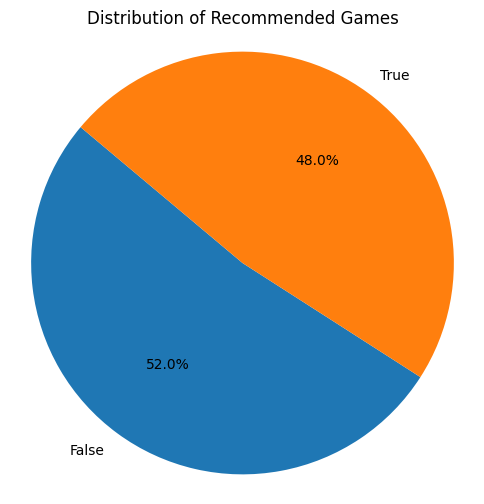

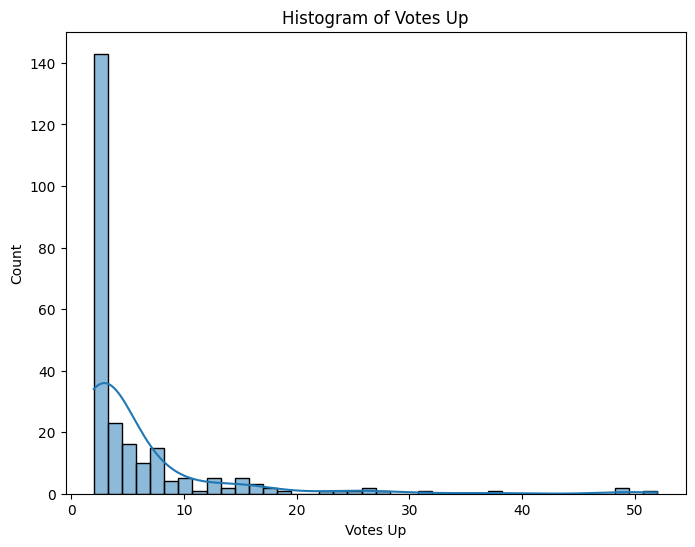

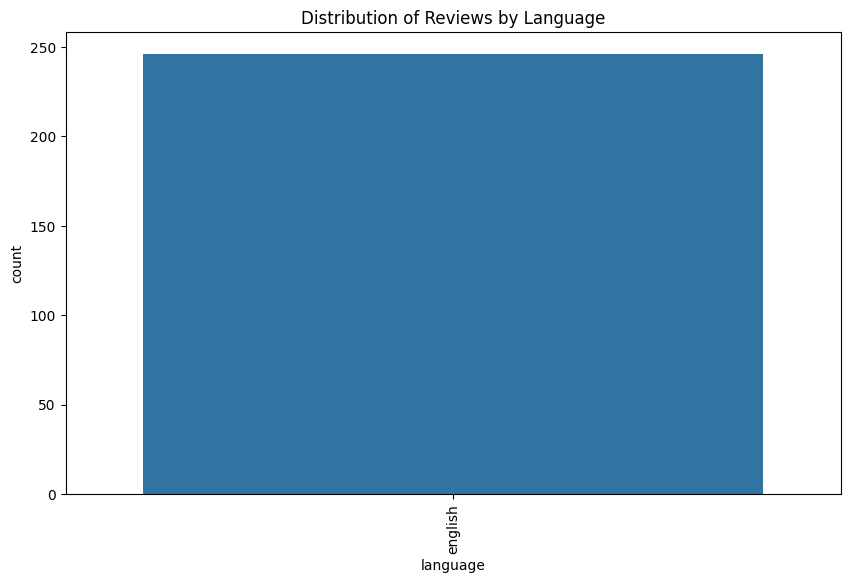

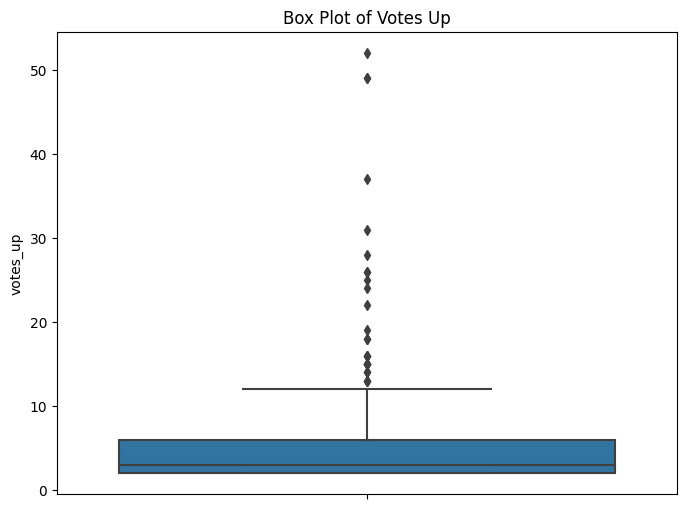

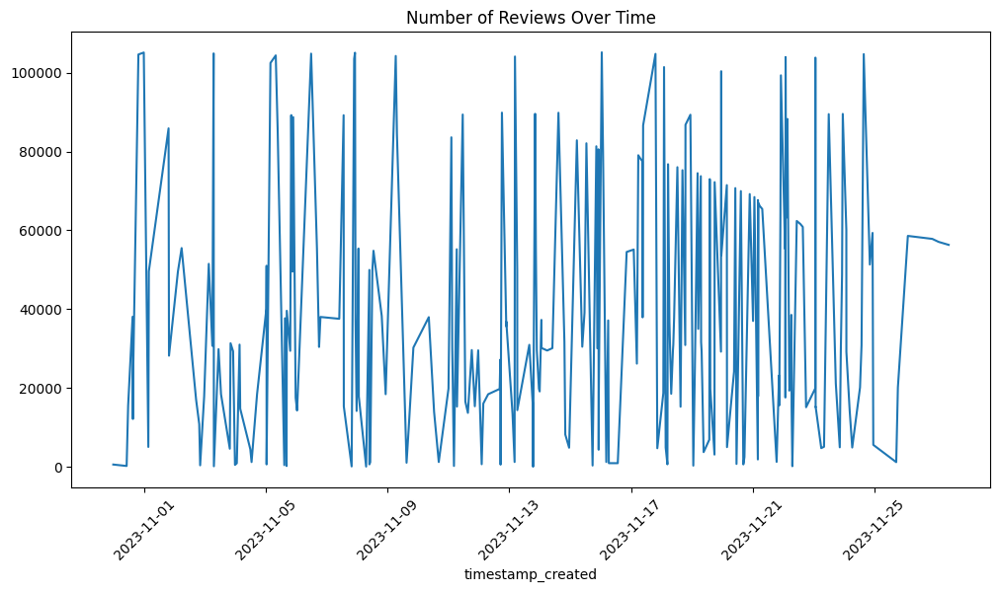

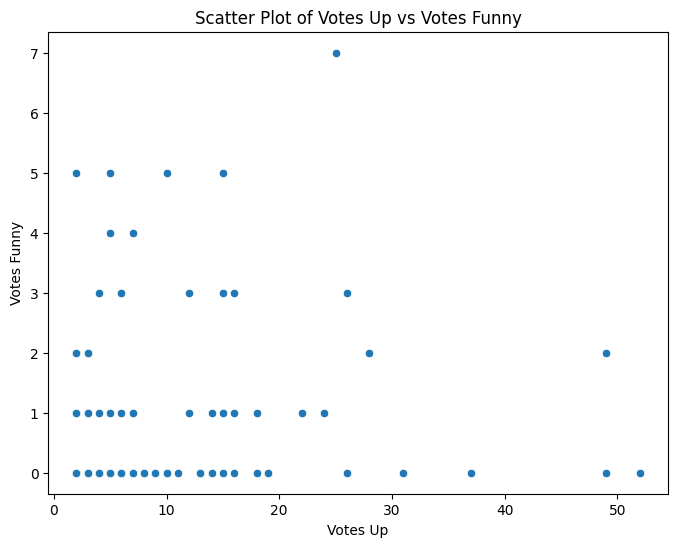

<ipython-input-25-db927f00eeff>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['release_date'] = pd.to_datetime(df_selected['release_date'])
<ipython-input-25-db927f00eeff>:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['release_year'] = df_selected['release_date'].dt.year
<ipython-input-25-db927f00eeff>:51: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only

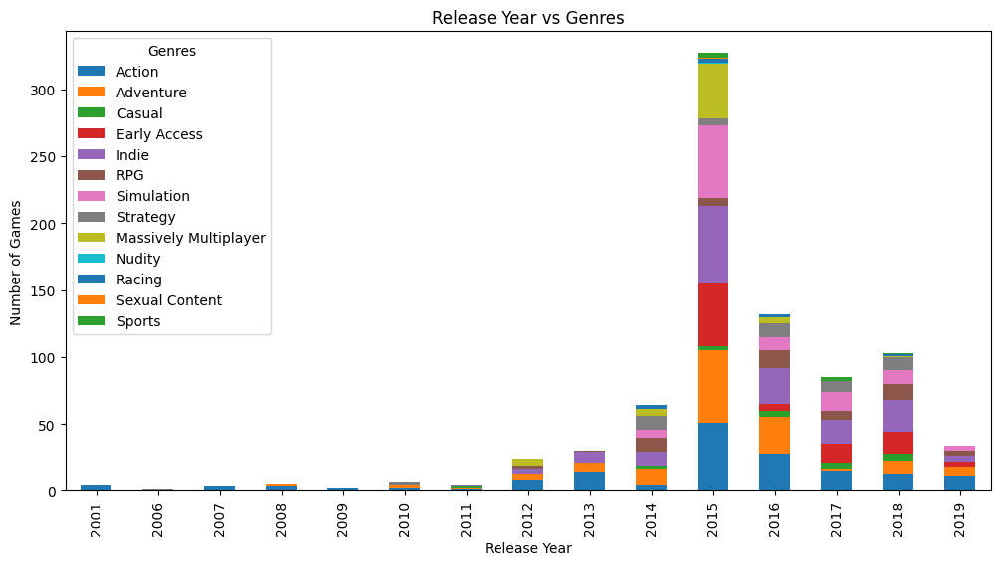

In [ ]:
# 1. Pie Chart for 'Recommended'
recommended_counts = df['Recommended'].value_counts()

plt.figure(figsize=(6, 6))
plt.pie(recommended_counts, labels=recommended_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Recommended Games')
plt.axis('equal')

plt.show()

# 2. Histogram for 'votes_up'
plt.figure(figsize=(8, 6))
sns.histplot(df['votes_up'], kde=True)
plt.title('Histogram of Votes Up')
plt.xlabel('Votes Up')
plt.show()

# 3. Bar Plot for 'language'
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='language')
plt.title('Distribution of Reviews by Language')
plt.xticks(rotation=90)
plt.show()

# 4. Box Plot for 'votes_up'
plt.figure(figsize=(8, 6))
sns.boxplot(y=df['votes_up'])
plt.title('Box Plot of Votes Up')
plt.show()

# 5. Time Series Plot for 'timestamp_created'
plt.figure(figsize=(12, 6))
sns.lineplot(data=df, x='timestamp_created', y=df.index)
plt.title('Number of Reviews Over Time')
plt.xticks(rotation=45)
plt.show()

# 6. Scatter Plot for 'votes_up' vs 'votes_funny'
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='votes_up', y='votes_funny')
plt.title('Scatter Plot of Votes Up vs Votes Funny')
plt.xlabel('Votes Up')
plt.ylabel('Votes Funny')
plt.show()

# 7. Bar Plot for release_date vs genre[]
selected_columns = ['release_date', 'Action', 'Adventure', 'Casual', 'Early Access', 'Indie', 'RPG', 'Simulation', 'Strategy','Massively Multiplayer','Nudity','Racing','Sexual Content','Sports']
df_selected = df[selected_columns]
df_selected['release_date'] = pd.to_datetime(df_selected['release_date'])
df_selected['release_year'] = df_selected['release_date'].dt.year
genre_counts = df_selected.groupby('release_year').sum()
plt.figure(figsize=(12, 6))
genre_counts.plot(kind='bar', stacked=True, ax=plt.gca())
plt.xlabel('Release Year')
plt.ylabel('Number of Games')
plt.title('Release Year vs Genres')
plt.legend(title='Genres')
plt.show()


In [ ]:
correlation_matrix = df.corr()
correlation_matrix

<ipython-input-26-f471181e404f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


,app_id,Recommended,recommendationid,voted_up,votes_up,votes_funny,weighted_vote_score,comment_count,steam_purchase,received_for_free,steamid,num_games_owned,num_reviews,playtime_forever,playtime_last_two_weeks,playtime_at_review,last_played,Action,Adventure,Casual,Early Access,Free to Play,Indie,Massively Multiplayer,Nudity,RPG,Racing,Sexual Content,Simulation,Sports,Strategy
app_id,1.000000,0.015084,0.013335,0.015084,0.076117,-0.016257,0.015275,-0.031399,0.035834,0.001613,-0.059634,0.106733,0.063467,-0.045206,0.057495,-0.044714,0.105904,-0.221447,-0.114152,0.167484,0.406773,-0.073073,0.215275,-0.115161,-0.001439,0.062987,0.025784,-0.001439,0.229484,0.033544,-0.042892
Recommended,0.015084,1.000000,-0.036314,1.000000,0.019618,-0.115288,0.268283,0.031371,0.056105,0.008375,0.267434,-0.093267,-0.090284,-0.142102,0.027171,-0.141970,-0.031950,-0.132215,-0.185131,0.190740,-0.345580,-0.088258,-0.208140,-0.488711,0.066540,0.080303,0.116279,0.066540,-0.249443,0.080369,-0.063963
recommendationid,0.013335,-0.036314,1.000000,-0.036314,-0.185668,-0.141248,-0.118337,-0.094652,0.094417,-0.048520,-0.104938,-0.026646,0.009031,0.082159,-0.012659,0.083074,0.102755,0.016657,0.056375,-0.029733,0.225365,-0.105566,0.101011,0.165162,-0.072994,-0.020327,-0.039226,-0.072994,0.099595,0.078636,-0.142452
voted_up,0.015084,1.000000,-0.036314,1.000000,0.019618,-0.115288,0.268283,0.031371,0.056105,0.008375,0.267434,-0.093267,-0.090284,-0.142102,0.027171,-0.141970,-0.031950,-0.132215,-0.185131,0.190740,-0.345580,-0.088258,-0.208140,-0.488711,0.066540,0.080303,0.116279,0.066540,-0.249443,0.080369,-0.063963
votes_up,0.076117,0.019618,-0.185668,0.019618,1.000000,0.230113,0.415620,0.243853,-0.070578,0.018241,0.020439,-0.039985,-0.043393,-0.086194,-0.021570,-0.086198,0.045292,0.092000,-0.093226,-0.010025,-0.084954,0.085207,-0.068586,-0.091179,-0.015177,-0.040694,0.006675,-0.015177,-0.124473,-0.043979,-0.068589
votes_funny,-0.016257,-0.115288,-0.141248,-0.115288,0.230113,1.000000,-0.047263,0.244803,-0.136025,-0.007688,0.142030,0.054543,0.082667,-0.089836,-0.027573,-0.090294,-0.029760,-0.027318,-0.062917,0.102770,-0.128548,0.141601,0.015723,-0.129313,0.156585,0.115183,0.083899,0.156585,-0.103500,-0.025110,-0.001947
weighted_vote_score,0.015275,0.268283,-0.118337,0.268283,0.415620,-0.047263,1.000000,0.078762,0.015268,-0.030604,0.149001,-0.161937,-0.205723,-0.090653,0.049249,-0.090572,0.046769,-0.076454,-0.126623,-0.007451,-0.149368,0.084678,-0.151503,-0.168770,0.031854,0.001283,0.032437,0.031854,-0.084701,0.027112,-0.009306
comment_count,-0.031399,0.031371,-0.094652,0.031371,0.243853,0.244803,0.078762,1.000000,-0.087091,0.176058,-0.021366,-0.044320,-0.029018,-0.032333,-0.052331,-0.032506,-0.198082,-0.003836,0.117762,0.127113,-0.050131,0.044970,0.089184,-0.034195,-0.016451,0.100863,-0.050178,-0.016451,-0.081593,-0.044067,0.010375
steam_purchase,0.035834,0.056105,0.094417,0.056105,-0.070578,-0.136025,0.015268,-0.087091,1.000000,-0.329690,0.052153,-0.108644,-0.059954,-0.021057,-0.233624,-0.019223,0.023600,0.024864,0.080908,-0.112250,0.078220,-0.385739,0.065143,-0.107494,0.039889,-0.092636,-0.022923,0.039889,0.082950,-0.001991,-0.187925
received_for_free,0.001613,0.008375,-0.048520,0.008375,0.018241,-0.007688,-0.030604,0.176058,-0.329690,1.000000,-0.070570,0.092517,-0.005682,-0.008430,0.123044,-0.009135,-0.066896,0.024789,-0.011734,0.164724,-0.064578,-0.054293,0.115087,-0.015469,-0.013151,-0.013570,0.069530,-0.013151,0.000684,0.088574,0.006868


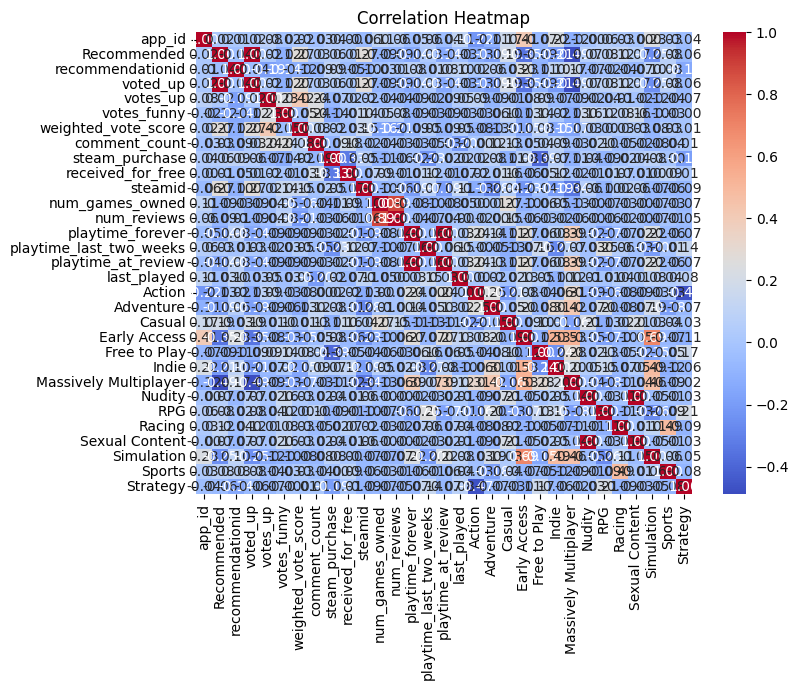

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

In [ ]:
Q1 = df['votes_up'].quantile(0.25)
Q3 = df['votes_up'].quantile(0.75)
IQR = Q3 - Q1

df = df[~((df['votes_up'] < (Q1 - 1.5 * IQR)) | (df['votes_up'] > (Q3 + 1.5 * IQR)))]
df = df[(np.abs(stats.zscore(df['votes_up'])) < 3)]


In [ ]:
upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))

columns_to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] >= 0.9)]

df = df.drop(columns=columns_to_drop)

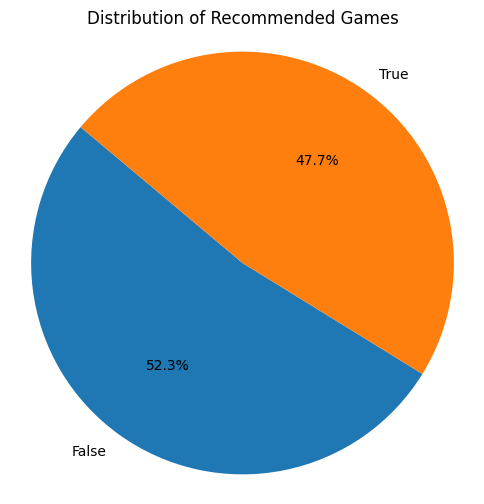

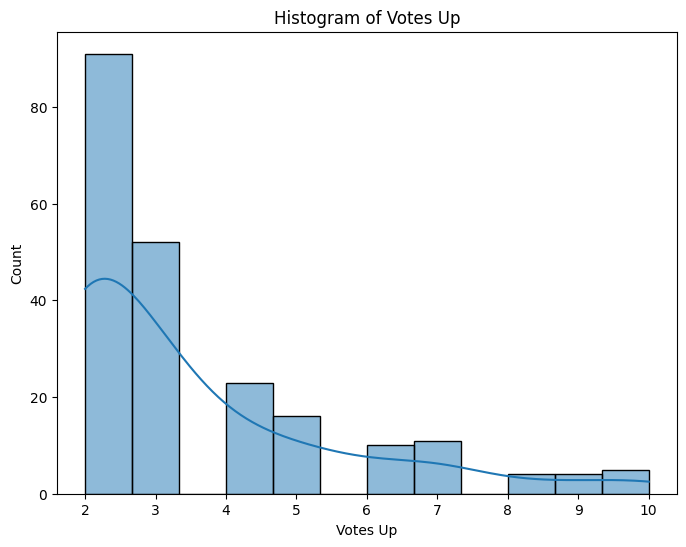

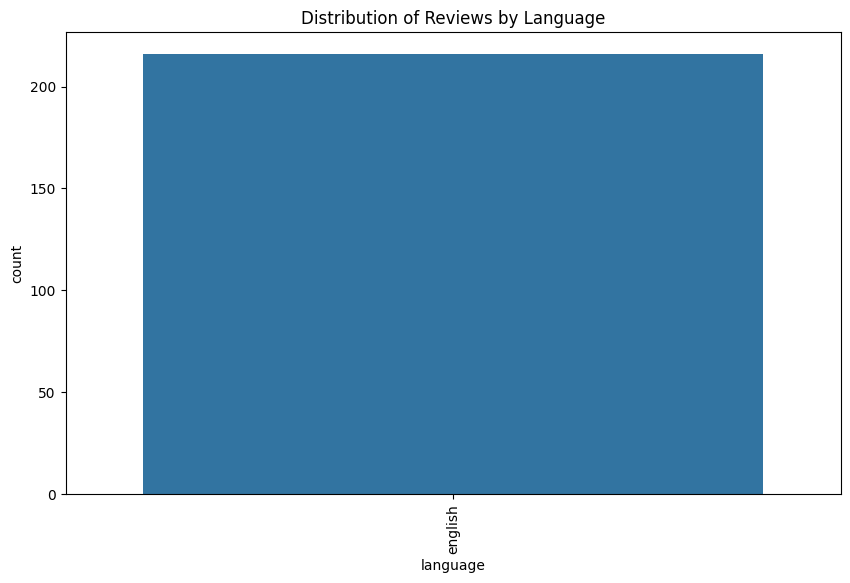

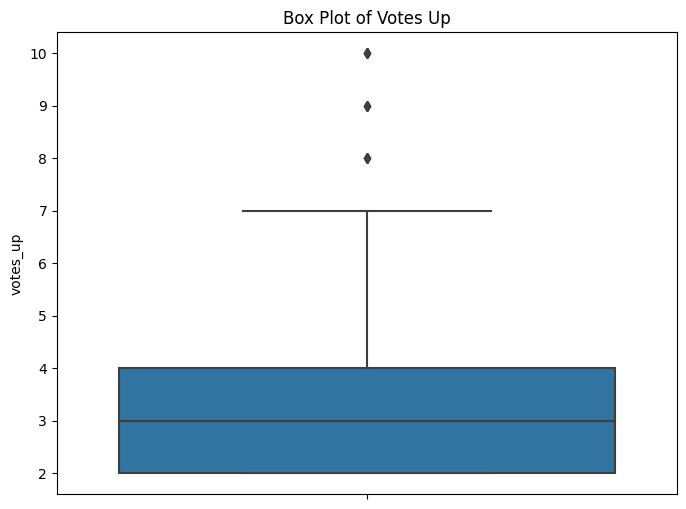

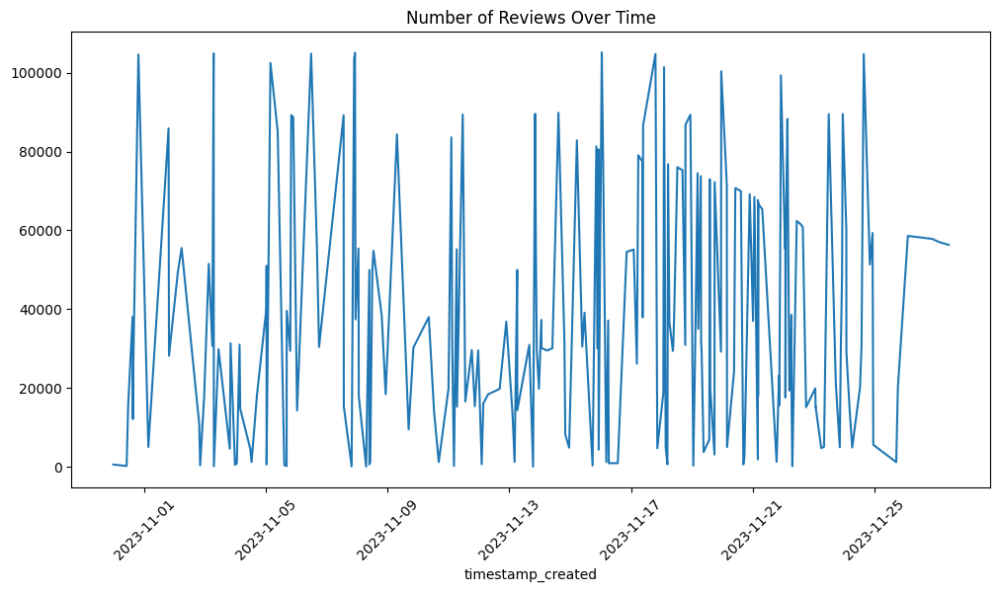

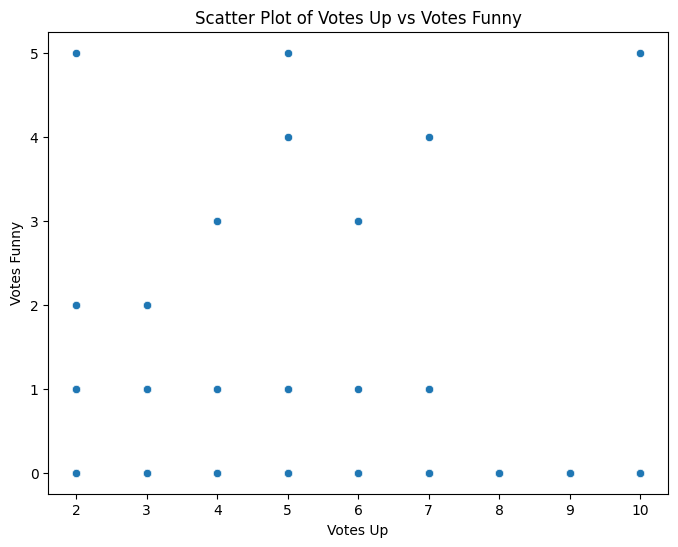

<ipython-input-30-4acbbb489c72>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['release_date'] = pd.to_datetime(df_selected['release_date'])
<ipython-input-30-4acbbb489c72>:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['release_year'] = df_selected['release_date'].dt.year
<ipython-input-30-4acbbb489c72>:51: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only

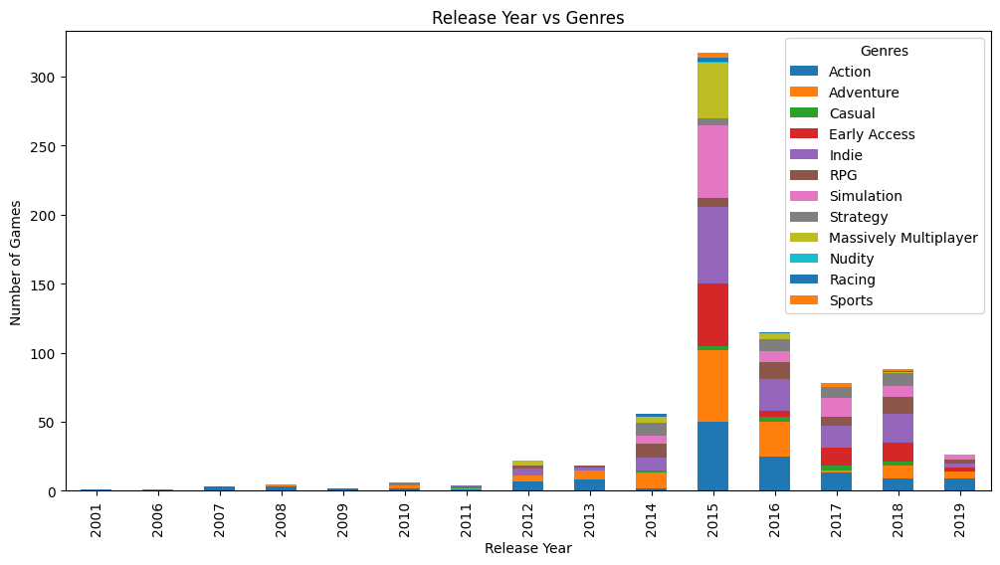

In [ ]:
# 1. Pie Chart for 'Recommended'
recommended_counts = df['Recommended'].value_counts()

plt.figure(figsize=(6, 6))
plt.pie(recommended_counts, labels=recommended_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Recommended Games')
plt.axis('equal')

plt.show()

# 2. Histogram for 'votes_up'
plt.figure(figsize=(8, 6))
sns.histplot(df['votes_up'], kde=True)
plt.title('Histogram of Votes Up')
plt.xlabel('Votes Up')
plt.show()

# 3. Bar Plot for 'language'
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='language')
plt.title('Distribution of Reviews by Language')
plt.xticks(rotation=90)
plt.show()

# 4. Box Plot for 'votes_up'
plt.figure(figsize=(8, 6))
sns.boxplot(y=df['votes_up'])
plt.title('Box Plot of Votes Up')
plt.show()

# 5. Time Series Plot for 'timestamp_created'
plt.figure(figsize=(12, 6))
sns.lineplot(data=df, x='timestamp_created', y=df.index)
plt.title('Number of Reviews Over Time')
plt.xticks(rotation=45)
plt.show()

# 6. Scatter Plot for 'votes_up' vs 'votes_funny'
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='votes_up', y='votes_funny')
plt.title('Scatter Plot of Votes Up vs Votes Funny')
plt.xlabel('Votes Up')
plt.ylabel('Votes Funny')
plt.show()

# 7. Bar Plot for release_date vs genre[]
selected_columns = ['release_date', 'Action', 'Adventure', 'Casual', 'Early Access', 'Indie', 'RPG', 'Simulation', 'Strategy','Massively Multiplayer','Nudity','Racing','Sports']
df_selected = df[selected_columns]
df_selected['release_date'] = pd.to_datetime(df_selected['release_date'])
df_selected['release_year'] = df_selected['release_date'].dt.year
genre_counts = df_selected.groupby('release_year').sum()
plt.figure(figsize=(12, 6))
genre_counts.plot(kind='bar', stacked=True, ax=plt.gca())
plt.xlabel('Release Year')
plt.ylabel('Number of Games')
plt.title('Release Year vs Genres')
plt.legend(title='Genres')
plt.show()


In [ ]:
df = df[(df['votes_up'] <= 7)]
df.reset_index(drop=True, inplace=True)


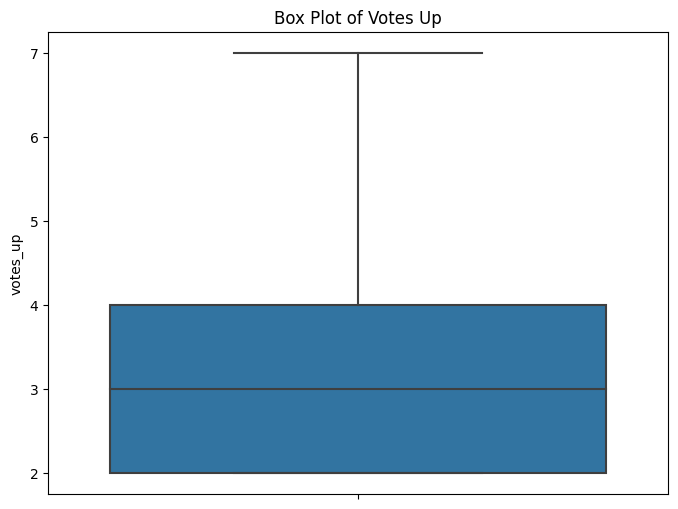

In [ ]:
# 4. Box Plot for 'votes_up'
plt.figure(figsize=(8, 6))
sns.boxplot(y=df['votes_up'])
plt.title('Box Plot of Votes Up')
plt.show()

לעשות גרף של שנים על הז'אנר המועדף

In [ ]:
correlation_matrix = df.corr()
correlation_matrix

<ipython-input-32-f471181e404f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


,app_id,Recommended,recommendationid,votes_up,votes_funny,weighted_vote_score,comment_count,steam_purchase,received_for_free,steamid,num_games_owned,num_reviews,playtime_forever,playtime_last_two_weeks,last_played,Action,Adventure,Casual,Early Access,Free to Play,Indie,Massively Multiplayer,Nudity,RPG,Racing,Simulation,Sports,Strategy
app_id,1.000000,0.020813,0.068209,-0.015777,-0.100318,0.009442,-0.024957,0.043376,0.010895,-0.049989,0.094078,0.064863,-0.054061,0.081110,0.089313,-0.238179,-0.163990,0.132027,0.419311,-0.092761,0.261933,-0.116200,-0.002833,0.081059,0.027168,0.194698,0.034527,-0.053715
Recommended,0.020813,1.000000,-0.047744,-0.128785,-0.235269,0.266506,-0.130135,0.076614,0.035411,0.269645,-0.085982,-0.096978,-0.138482,0.008474,-0.009144,-0.156553,-0.248220,0.182182,-0.390713,-0.098283,-0.218024,-0.508635,0.073551,0.082648,0.143507,-0.239788,0.089459,-0.027602
recommendationid,0.068209,-0.047744,1.000000,-0.119096,-0.153083,-0.057533,-0.084732,0.074772,-0.078007,-0.129352,-0.024949,0.003074,0.067871,-0.000639,0.126566,-0.002965,0.047746,-0.005174,0.242403,-0.099406,0.096559,0.181671,-0.083309,-0.047581,-0.012697,0.120631,0.069925,-0.148086
votes_up,-0.015777,-0.128785,-0.119096,1.000000,0.181941,0.206227,0.069850,-0.065445,0.086303,-0.068509,-0.081324,-0.049912,0.063050,-0.000726,-0.015373,0.033853,0.006985,-0.100224,0.030368,0.117784,-0.035915,0.065445,0.038983,0.022188,0.031095,-0.016756,0.086303,0.054976
votes_funny,-0.100318,-0.235269,-0.153083,0.181941,1.000000,-0.121991,0.407422,-0.124107,0.022193,0.052305,0.108687,0.130747,-0.069855,-0.007150,-0.062390,-0.019231,-0.035012,0.023551,-0.153833,0.061455,0.041767,-0.078959,0.223913,0.176011,-0.074345,-0.142707,-0.009987,0.056064
weighted_vote_score,0.009442,0.266506,-0.057533,0.206227,-0.121991,1.000000,-0.065657,0.071679,-0.051230,0.146457,-0.173053,-0.212880,-0.049838,0.046913,0.045680,-0.117102,-0.101262,-0.042951,-0.118726,0.058159,-0.122839,-0.150416,0.047560,0.049174,0.064592,-0.018919,0.062317,0.030284
comment_count,-0.024957,-0.130135,-0.084732,0.069850,0.407422,-0.065657,1.000000,-0.029217,0.035025,-0.039402,-0.046648,-0.029002,-0.019414,-0.087256,0.005891,0.077469,0.056542,-0.012424,-0.010361,0.105175,0.108274,0.012125,-0.017213,0.156514,-0.046232,-0.049447,-0.046232,0.009273
steam_purchase,0.043376,0.076614,0.074772,-0.065445,-0.124107,0.071679,-0.029217,1.000000,-0.326255,0.068808,-0.106146,-0.072026,-0.032655,-0.235904,0.010312,0.033247,0.071664,-0.010052,0.083968,-0.363051,0.056845,-0.083462,0.040756,-0.124472,-0.015025,0.071241,-0.015025,-0.198471
received_for_free,0.010895,0.035411,-0.078007,0.086303,0.022193,-0.051230,0.035025,-0.326255,1.000000,-0.068605,-0.000663,-0.016543,0.008362,0.206167,0.041850,0.030948,0.007488,0.049822,-0.038278,-0.045234,0.087041,0.015025,-0.013297,0.019580,0.112245,0.052600,0.112245,0.042128
steamid,-0.049989,0.269645,-0.129352,-0.068509,0.052305,0.146457,-0.039402,0.068808,-0.068605,1.000000,-0.091435,-0.066676,-0.200084,0.101324,0.114691,-0.148152,-0.269393,0.005322,-0.256564,-0.093258,-0.177648,-0.355475,0.065830,-0.074384,-0.024384,-0.092424,-0.069352,-0.061485


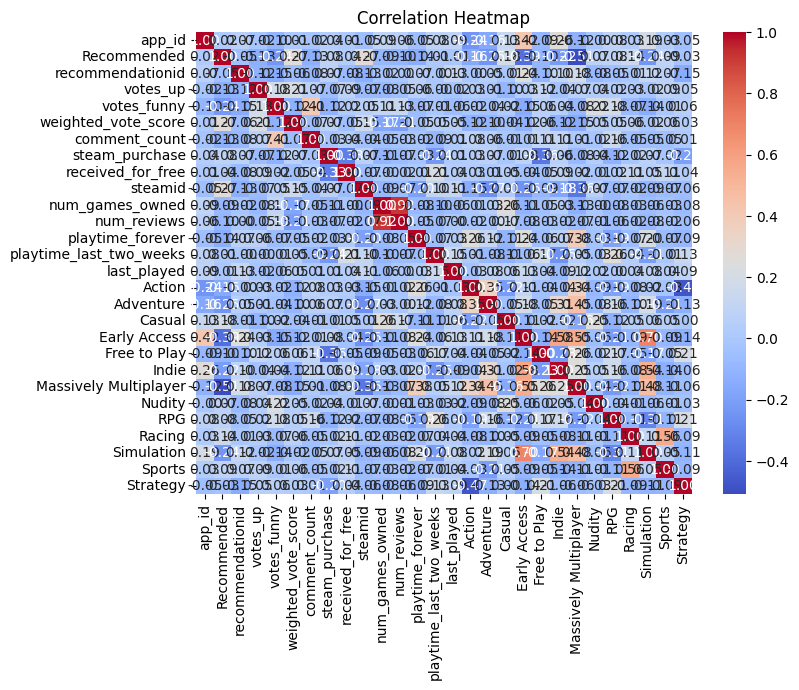

In [ ]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

# Processing

In [ ]:
braille_pattern = re.compile(r'^[⠠-⠿⠀]+$')
df = df[~df['review'].str.match(braille_pattern)]

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

In [ ]:
def generate_ngrams(tokens, n):
    return list(ngrams(tokens, n))

In [ ]:
def preprocess_text(text):
    text = text.lower()
    text = text.translate(str.maketrans('', '', string.punctuation))
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word not in stopwords.words('english')]
    return tokens

In [ ]:
ngram_size = 2
df['processed_review'] = df['review'].apply(preprocess_text)
df['ngrams'] = df['processed_review'].apply(lambda tokens: generate_ngrams(tokens, ngram_size))

ngram_freq_dict = Counter()
for ngram_list in df['ngrams']:
    for ngram in ngram_list:
        ngram_freq_dict[ngram] += 1


In [ ]:
df['processed_review'] = df['review'].apply(preprocess_text)

In [ ]:
word_freq_dict = Counter()
for tokens in df['processed_review']:
    word_freq_dict.update(tokens)


In [ ]:
word_freq_dict

Counter({'game': 1003,
         'living': 7,
         'brain': 6,
         'past': 14,
         '3': 47,
         'weeks': 5,
         'lot': 48,
         'things': 54,
         'shouldnt': 12,
         'click': 10,
         'timed': 3,
         'missions': 13,
         'characters': 54,
         'constantly': 10,
         'bugging': 2,
         'fuck': 4,
         'otis': 1,
         'unforgivingly': 1,
         'tough': 2,
         'boss': 10,
         'fights': 9,
         'disgusting': 3,
         'shooting': 9,
         'controls': 25,
         'god': 7,
         'awful': 10,
         'ai': 32,
         'yet': 28,
         'spot': 6,
         'top': 17,
         '10': 30,
         'games': 172,
         'time': 190,
         'cant': 62,
         'find': 78,
         'words': 10,
         'explain': 10,
         'might': 50,
         'zombie': 4,
         'movie': 8,
         'brainrot': 1,
         'talking': 2,
         'something': 36,
         'said': 18,
         'fun': 116,
 

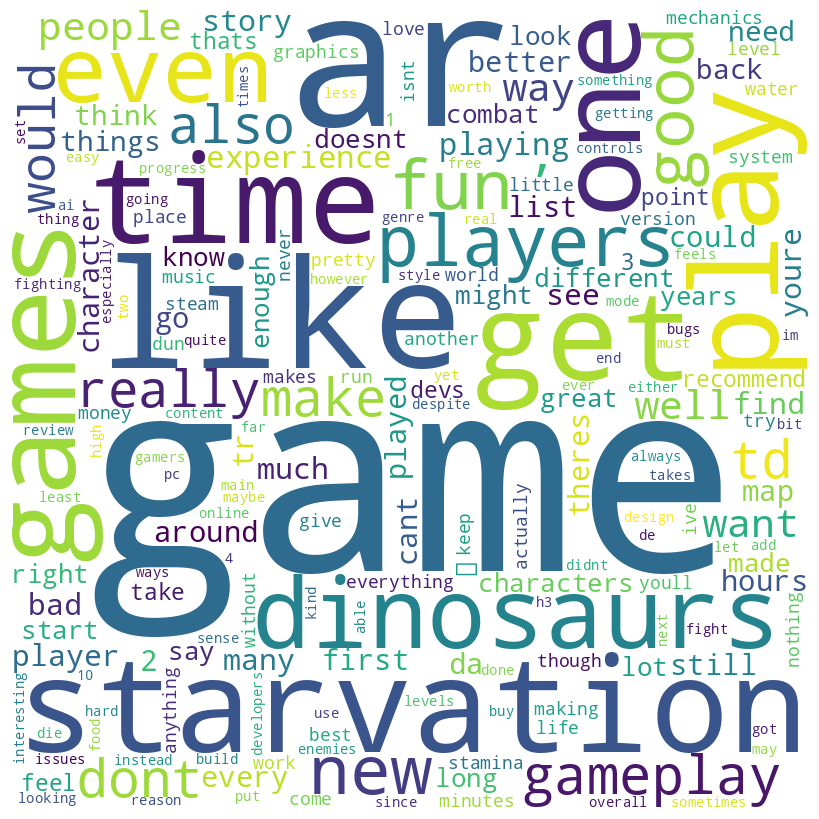

In [ ]:
wordcloud = WordCloud(width=800, height=800, background_color='white').generate_from_frequencies(word_freq_dict)

plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()


categories

ost;gameplay;graphics

In [ ]:
df = df.drop(df[df['votes_funny'] > 5].index)
df.reset_index(drop=True, inplace=True)

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

In [ ]:
def preprocess_sentences(text):
    text = text.lower()
    sentences = sent_tokenize(text)
    cleaned_sentences = []

    for sentence in sentences:
        sentence = sentence.translate(str.maketrans('', '', string.punctuation))
        tokens = sentence.split()
        tokens = [word for word in tokens if word not in stopwords.words('english')]
        cleaned_sentences.append(" ".join(tokens))

    return cleaned_sentences


In [ ]:
df.drop('processed_review', axis=1, inplace=True)

In [ ]:
df['processed_review'] = df['review'].apply(preprocess_sentences)
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

In [ ]:
df = df.drop(df[df['review'] == ''].index)
df.reset_index(drop=True, inplace=True)

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

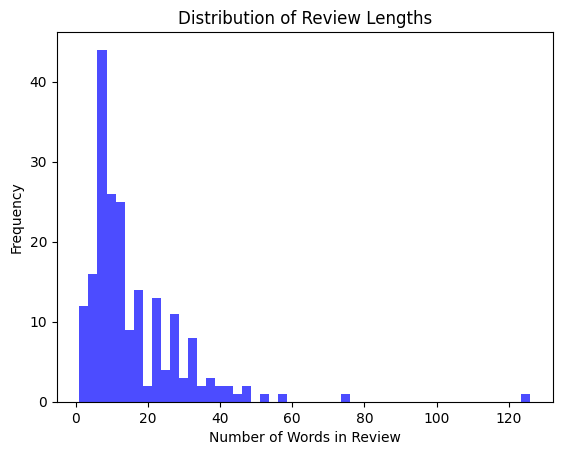

In [ ]:
review_lengths = df['processed_review'].apply(lambda x: len(x))

plt.hist(review_lengths, bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Review Lengths')
plt.xlabel('Number of Words in Review')
plt.ylabel('Frequency')
plt.show()

# S-Bert and RandomForest Models

In [ ]:
model = SentenceTransformer('all-MiniLM-L6-v2')

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


.gitattributes:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

data_config.json:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

train_script.py:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

In [ ]:
df.drop('ngrams', axis=1, inplace=True)

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

average_scores = df.groupby('title')['sentiment_score'].mean().reset_index()

plt.figure(figsize=(24, 16))

plt.scatter(df['sentiment_score'], df['title'], alpha=0.5, label='Individual Scores')

plt.scatter(average_scores['sentiment_score'], average_scores['title'], color='red', marker='s', s=50, label='Average Scores')

plt.title('Sentiment Score vs. Title')
plt.xlabel('Sentiment Score')
plt.ylabel('Title')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
df = df.groupby('app_id').filter(lambda x: len(x) >= 1)

In [ ]:
keywords = {
    'gameplay': ['Immersive', 'Dynamic', 'Strategic', 'Responsive', 'Intuitive', 'Challenging', 'Seamless', 'Adaptive', 'Engaging', 'Tactical', 'Fluid', 'Puzzling', 'Navigable', 'Interactive', 'Strategic', 'Reactive', 'Versatile', 'Progressive', 'Innovative', 'Satisfying','story', 'missions', 'characters', 'shooting', 'controls', 'boss fights', 'gameplay', 'setting', 'exploration', 'scavenging', 'weapons', 'player interaction', 'attack', 'sandbox', 'exploring', 'survival', 'combat', 'abilities', 'evolving', 'weapons', 'resource production', 'mechanics', 'learning curve', 'decision-making', 'consequence', 'frustrating', 'difficulty levels', 'multiplayer', 'online', 'single-player', 'campaign', 'playthrough', 'terraforming', 'colonization', 'space', 'outposts', 'domes', 'rockets', 'balancing', 'resource distribution', 'disasters', 'replayability', 'achievements', 'challenges', 'strategy', 'simulations'],
    'soundtrack': ['Melodic', 'Atmospheric', 'Harmonious', 'Cinematic', 'Evocative', 'Enchanting', 'Uplifting', 'Lyrical', 'Emotional', 'Energetic', 'Ambient', 'Captivating', 'Haunting', 'Majestic', 'Rhythmic', 'Soulful', 'Orchestral', 'Nostalgic', 'Mesmerizing', 'music', 'soundtrack', 'themes', 'sound', 'relaxing', 'plays', 'various', 'psychopath', 'catchy', 'beat', 'sequence', 'type', 'ear', 'credits', 'catchy', 'cinematic', 'immersive', 'atmospheric', 'emotional', 'orchestral', 'repetitive'],
    'visuals': ['Photorealistic', 'Vibrant', 'Aesthetic', 'Cinematic', 'Crisp', 'Stunning', 'Immersive', 'Detailed', 'Sleek', 'Striking', 'Polished', 'Colorful', 'Realistic', 'Atmospheric', 'Dynamic', 'Vivid', 'Clean', 'Surreal', 'Sharp', 'Futuristic', 'discovery', 'visual', 'elements', 'textures', 'effects', 'environment', 'atmosphere', 'surface', 'atmospheric', 'representation', 'cracks', 'facade', 'creative', 'innovative', 'solutions', 'improving', 'enhancing', 'graphics', 'visuals', 'improvements']
}

In [ ]:
sia = SentimentIntensityAnalyzer() #init vader

categories = ['visuals', 'soundtrack', 'gameplay']
categories_emb = [model.encode(c) for c in categories]
for category in keywords.keys():
    df[category] = None

final_cat_dic = {'visuals':[], 'soundtrack':[], 'gameplay':[]}

for i, review_list in df['processed_review'].items():
  #init per game
  cat_dic = {'visuals':[], 'soundtrack':[], 'gameplay':[]}
  min_dist = np.inf
  cat=None

  for r in review_list:
    r_emb = model.encode(r) #embeddings of review
    for i,c_emb in enumerate(categories_emb): #O(1)
    #look for category that is the closest to review, to understand what the review is talking about
      closest_cat= cosine(c_emb,r_emb)
      if closest_cat<min_dist:
        min_dist = closest_cat
        cat = categories[i] #best fit category

    sen = sia.polarity_scores(r)['compound'] #a normalized compound score of sentimenr of sentence

    #now we have per review the setiment and the cat

    if cat: #category for review is not None
      cat_dic[cat].append(sen) #add sentiment to the list of occurces for that cat

  #now we have per review a dic of categories and their sentiment
  for cal,cal_sent in cat_dic.items():
    if cal_sent: #not empty
      final_cat_dic[cal].append(np.mean(cal_sent))
    else:
      final_cat_dic[cal].append(0)

#now we gat a dic with 3 categories, for each the values are a list of the averaged sentiment per game
#such that final_cat_dic['graphics'][i] would be the sentiment value of talking about graphics across all revirews given to game i


In [ ]:
for key in final_cat_dic:
  df[key] = final_cat_dic[key]

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

In [ ]:
final_cat_dic

{'visuals': [0,
  0,
  0,
  0.04999999999999999,
  -0.019199999999999995,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  -0.8225,
  0,
  0.30457777777777784,
  0,
  0,
  0,
  0.18015555555555554,
  0,
  0,
  0.24175833333333338,
  0,
  -0.12448000000000001,
  0,
  0,
  0.0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0.0,
  0,
  0,
  0,
  0,
  0.13865555555555556,
  0.02916363636363637,
  0,
  0,
  0,
  0,
  0,
  0,
  0.5859,
  0,
  0.23047142857142858,
  0,
  0,
  0.5859,
  0.4937454545454546,
  -0.12219999999999999,
  0.09963,
  0,
  0,
  0,
  0.2228,
  0,
  0,
  0,
  0,
  0.345,
  0,
  0.4404,
  -0.04959999999999999,
  0.18702272727272726,
  0.17001176470588236,
  0,
  0,
  0.0,
  0.10809000000000002,
  0.05269999999999999,
  0,
  0,
  0,
  0,
  0,
  0,
  0.8779,
  0.45424999999999993,
  0,
  0,
  0,
  0,
  0.0564153846153846,
  0.34,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0.1366,
  0,
  0,
  0,
  0,
  0,
  0.0,
  0,
  -0.08266666666666667,
  0,
  0,
  0.2273666666666667,

In [ ]:
avg_scores = df.groupby('app_id')[['visuals', 'soundtrack', 'gameplay']].mean()

for category in ['visuals', 'soundtrack', 'gameplay']:
    df[category + '_avg'] = df['app_id'].map(avg_scores[category])
def compare_to_avg(row, category):
    if row[category + '_avg'] is None:
        return 0
    elif row[category] is None:
        return -1
    elif row[category] > row[category + '_avg']:
        return 1
    elif row[category] < row[category + '_avg']:
        return -1
    else:
        return 0
for category in ['visuals', 'soundtrack', 'gameplay']:
    df[category + '_compared_to_avg'] = df.apply(compare_to_avg, args=(category,), axis=1)

In [ ]:
df

app_id                                              title  Recommended  \
0    427190                                       DEAD RISING®         True   
1    427190                                       DEAD RISING®         True   
2    427190                                       DEAD RISING®         True   
3    718560                            Scythe: Digital Edition         True   
4    464920                                     Surviving Mars         True   
5    290300                                       Rebel Galaxy         True   
6    290300                                       Rebel Galaxy         True   
7    357190                       ULTIMATE MARVEL VS. CAPCOM 3         True   
8    673610                                        Airport CEO         True   
9    384190                                               ABZU         True   
10   384190                                               ABZU         True   
11    21000                       LEGO® Batman™: The Videogame         True   
12    21000                       LEGO® Batman™: The Videogame         True   
13   249050                            Dungeon of the Endless™         True   
14   349300               Littlewitch Romanesque: Editio Regia         True   
15   349300               Littlewitch Romanesque: Editio Regia         True   
16   281610                       Homeworld: Deserts of Kharak         True   
17   281610                       Homeworld: Deserts of Kharak         True   
18   586140                            BlazBlue Centralfiction         True   
19   385800                                    NEKOPARA Vol. 0         True   
20   346940            Shadowrun: Hong Kong - Extended Edition         True   
21   977400         Cell to Singularity - Evolution Never Ends         True   
22    32400                           STAR WARS™ - Dark Forces         True   
23     6900                                Hitman: Codename 47         True   
24   314660                            Oddworld: New 'n' Tasty         True   
25   824720                                 Pure Rock Crawling         True   
26   242860                                             Verdun         True   
27   457140                                Oxygen Not Included         True   
28   457140                                Oxygen Not Included         True   
29   457140                                Oxygen Not Included         True   
30   457140                                Oxygen Not Included         True   
31   457140                                Oxygen Not Included         True   
32   527230                                       For The King         True   
33   527230                                       For The King         True   
34   527230                                       For The King         True   
35   205950                                      Jet Set Radio         True   
36   683320                                               GRIS         True   
37   236110                               Dungeon Defenders II         True   
38   654220                           Flash Point: Fire Rescue         True   
39   951240                                         Open Sewer         True   
40   951240                                         Open Sewer         True   
41   951240                                         Open Sewer         True   
42   951240                                         Open Sewer         True   
43   601150                                    Devil May Cry 5         True   
44   319510                            Five Nights at Freddy's         True   
45   319510                            Five Nights at Freddy's         True   
46   319510                            Five Nights at Freddy's         True   
47   319510                            Five Nights at Freddy's         True   
48   319510                            Five Nights at Freddy's         True   
49   319510                            Five Nights at F

In [ ]:
unique_rows_count = df[['visuals', 'soundtrack', 'gameplay']].nunique(axis=1).sum()

print(f"Number of unique rows with values in all three categories: {unique_rows_count}")


Number of unique rows with values in all three categories: 466


In [ ]:
genres_columns = genres_df.columns
genres_columns

Index(['Action', 'Adventure', 'Casual', 'Early Access', 'Free to Play',
       'Indie', 'Massively Multiplayer', 'Nudity', 'RPG', 'Racing',
       'Sexual Content', 'Simulation', 'Sports', 'Strategy'],
      dtype='object')

In [ ]:
X = df[['visuals_compared_to_avg',	'soundtrack_compared_to_avg',	'gameplay_compared_to_avg']]
y = df['Recommended']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
n_estimators_range = list(range(1, 101))


param_grid = dict(n_estimators=n_estimators_range)

grid1 = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='accuracy')

grid1.fit(X_train, y_train)

print(grid1.cv_results_)

{'mean_fit_time': array([0.00909984, 0.03540347, 0.05246394, 0.03237436, 0.05463474,
       0.06057668, 0.08387713, 0.06810062, 0.09126906, 0.11421769,
       0.07362936, 0.04766793, 0.04897292, 0.05566261, 0.06960561,
       0.05062804, 0.05111504, 0.0545012 , 0.05866621, 0.11540935,
       0.03553371, 0.03758316, 0.03445094, 0.03521824, 0.03746777,
       0.04172599, 0.04623268, 0.04566569, 0.06680357, 0.08455338,
       0.07984436, 0.07671521, 0.07859333, 0.08983455, 0.06813102,
       0.05582325, 0.0580143 , 0.05711071, 0.05713017, 0.05795505,
       0.05929058, 0.06150463, 0.06375034, 0.06329541, 0.06607306,
       0.06723585, 0.06693416, 0.06923823, 0.07435958, 0.12341692,
       0.12295153, 0.13408532, 0.13738441, 0.07727883, 0.08322868,
       0.08425612, 0.0853014 , 0.08318255, 0.08640063, 0.0862498 ,
       0.09175773, 0.08786988, 0.091819  , 0.11428339, 0.16093707,
       0.1650728 , 0.15669436, 0.1009969 , 0.10294542, 0.10372825,
       0.10572975, 0.10477169, 0.10964613, 0

In [ ]:
max_depth_range = list(range(1, 51))
param_grid = dict(max_depth=max_depth_range)

grid2 = GridSearchCV(RandomForestClassifier(), param_grid, cv=10, scoring='accuracy')

grid2.fit(X_train, y_train)


GridSearchCV(cv=10, estimator=RandomForestClassifier(),
             param_grid={'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
                                       23, 24, 25, 26, 27, 28, 29, 30, ...]},
             scoring='accuracy')

In [ ]:

print(grid1.best_score_)
print('==================================')
print(grid1.best_params_)
print('==================================')
print(grid1.best_estimator_)
print('==================================')
print(grid2.best_params_)

0.6852941176470588
{'n_estimators': 19}
RandomForestClassifier(n_estimators=19)
{'max_depth': 8}


In [ ]:
RFCModel = RandomForestClassifier(n_estimators=5)

RFCModel.fit(X_train, y_train)

RandomForestClassifier(n_estimators=5)

In [ ]:
predictions = RFCModel.predict(X_test)

accuracy = accuracy_score(y_test, predictions)
precision = precision_score(y_test, predictions)
recall = recall_score(y_test, predictions)
f1 = f1_score(y_test, predictions)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

Accuracy: 0.6341463414634146
Precision: 0.6190476190476191
Recall: 0.65
F1-score: 0.6341463414634146


In [ ]:
RFCModel = RandomForestClassifier(n_estimators=10, max_depth=42)

RFCModel.fit(X, y)


RandomForestClassifier(max_depth=42, n_estimators=10)

In [ ]:
predictions = RFCModel.predict(X_test)

accuracy = accuracy_score(y_test, predictions)
precision = precision_score(y_test, predictions)
recall = recall_score(y_test, predictions)
f1 = f1_score(y_test, predictions)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)

Accuracy: 0.7073170731707317
Precision: 0.75
Recall: 0.6
F1-score: 0.6666666666666665


In [ ]:
!pip install xgboost


In [ ]:

import xgboost as xgb

# Create DMatrix for XGBoost
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Define parameters for XGBoost
params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    # Add other hyperparameters as needed
}

# Train XGBoost model
xgb_model = xgb.train(params, dtrain)

# Make predictions
predictions = xgb_model.predict(dtest)

# Evaluate the model
accuracy = accuracy_score(y_test, predictions.round())
precision = precision_score(y_test, predictions.round())
recall = recall_score(y_test, predictions.round())
f1 = f1_score(y_test, predictions.round())

print("XGBoost Model:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


XGBoost Model:
Accuracy: 0.6585365853658537
Precision: 0.6666666666666666
Recall: 0.6
F1-score: 0.631578947368421


In [ ]:
!pip install lightgbm


In [ ]:
import lightgbm as lgb

# Create Dataset for LightGBM
lgb_train = lgb.Dataset(X_train, label=y_train)
lgb_eval = lgb.Dataset(X_test, label=y_test, reference=lgb_train)

# Define parameters for LightGBM
params = {
    'objective': 'binary',
    'metric': 'binary_logloss',
    # Add other hyperparameters as needed
}

# Train LightGBM model
lgb_model = lgb.train(params, lgb_train, num_boost_round=100, valid_sets=[lgb_eval])
# Make predictions
predictions = lgb_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, predictions.round())
precision = precision_score(y_test, predictions.round())
recall = recall_score(y_test, predictions.round())
f1 = f1_score(y_test, predictions.round())

print("LightGBM Model:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)


[LightGBM] [Info] Number of positive: 77, number of negative: 85
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 9
[LightGBM] [Info] Number of data points in the train set: 162, number of used features: 3
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475309 -> initscore=-0.098846
[LightGBM] [Info] Start training from score -0.098846
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

# Prediction

In [ ]:
#@title enter the review of the game you want to predict its success or failure:
review_input = " Counter-Strike 2 is the latest installment in the legendary series of first-person shooter games that have captivated millions of players around the world. In this game, you can join one of two teams: the terrorists, who seek to cause chaos and destruction, or the counter-terrorists, who strive to prevent and stop them. You can choose from a variety of weapons, equipment, and tactics to suit your playstyle and strategy. You can also customize your character\u2019s appearance, voice, and gestures to express your personality and mood.  The game offers a range of modes and scenarios to challenge your skills and test your nerves. You can play classic modes like Bomb Defusal and Hostage Rescue, where you have to complete specific objectives while fighting against the enemy team. You can also try new modes like Premier, where you can compete in a more serious and competitive environment, with exclusive rewards and rankings. You can also create your own custom games and maps, or join community servers and workshops to discover new and exciting content created by other players.  Counter-Strike 2 is powered by the Source 2 engine, which delivers stunning graphics and realistic physics. The game features enhanced lighting and shadows, detailed textures and models, and redesigned visual effects and animations. The game also has a dynamic and immersive soundtrack, composed by Mike Morasky, who also worked on Portal 2 and Team Fortress 2. The soundtrack adapts to the situation and the environment, creating a tense and thrilling atmosphere. The game also has improved sound quality and spatial audio, making it easier to locate enemies and allies by their footsteps and gunshots.  Counter-Strike 2 is the ultimate game for fans of action and strategy, offering a thrilling and rewarding experience that can be enjoyed solo or with friends. Whether you are a veteran or a newcomer, you will find something to love and enjoy in this game." # @param {type:"string"}

In [ ]:
#@title enter the genres of the game you want to predict(write the genres with a capital letter at the start and seperate them with commas) the genres that can be used in this model are Action, Adventure, Casual, Early Access, Free to Play, Indie, Massively Multiplayer, Nudity, RPG, Racing, Simulation, Sports, and Strategy:
genre_input = 'Massively Multiplayer, Strategy, Free to Play' #@param {type:"string"}

In [ ]:
new_game_features = pd.DataFrame(columns=['review', 'Action', 'Adventure', 'Casual', 'Early Access', 'Free to Play', 'Indie', 'Massively Multiplayer', 'Nudity', 'RPG', 'Racing', 'Simulation', 'Sports', 'Strategy'])
new_game_features.loc[0, 'review'] = review_input
str_list = genre_input.split(',')

for genre in str_list:
    genre = genre.strip()
    if genre in new_game_features.columns:
        new_game_features.loc[0, genre] = 1
new_game_features = new_game_features.fillna(0)

new_game_features

,review,Action,Adventure,Casual,Early Access,Free to Play,Indie,Massively Multiplayer,Nudity,RPG,Racing,Simulation,Sports,Strategy
0,"Counter-Strike 2 is the latest installment in the legendary series of first-person shooter games that have captivated millions of players around the world. In this game, you can join one of two teams: the terrorists, who seek to cause chaos and destruction, or the counter-terrorists, who strive to prevent and stop them. You can choose from a variety of weapons, equipment, and tactics to suit your playstyle and strategy. You can also customize your character’s appearance, voice, and gestures to express your personality and mood. The game offers a range of modes and scenarios to challenge your skills and test your nerves. You can play classic modes like Bomb Defusal and Hostage Rescue, where you have to complete specific objectives while fighting against the enemy team. You can also try new modes like Premier, where you can compete in a more serious and competitive environment, with exclusive rewards and rankings. You can also create your own custom games and maps, or join community servers and workshops to discover new and exciting content created by other players. Counter-Strike 2 is powered by the Source 2 engine, which delivers stunning graphics and realistic physics. The game features enhanced lighting and shadows, detailed textures and models, and redesigned visual effects and animations. The game also has a dynamic and immersive soundtrack, composed by Mike Morasky, who also worked on Portal 2 and Team Fortress 2. The soundtrack adapts to the situation and the environment, creating a tense and thrilling atmosphere. The game also has improved sound quality and spatial audio, making it easier to locate enemies and allies by their footsteps and gunshots. Counter-Strike 2 is the ultimate game for fans of action and strategy, offering a thrilling and rewarding experience that can be enjoyed solo or with friends. Whether you are a veteran or a newcomer, you will find something to love and enjoy in this game.",0,0,0,0,1,0,1,0,0,0,0,0,1


In [ ]:
new_game_features['processed_review'] = new_game_features['review'].apply(lambda review: preprocess_sentences(review))

In [ ]:
sia = SentimentIntensityAnalyzer() #init vader

for category in keywords.keys():
    new_game_features[category] = None

final_cat_dic2 = {'visuals':[], 'soundtrack':[], 'gameplay':[]}

for i, review_list in new_game_features['processed_review'].items():
  #init per game
  cat_dic = {'visuals':[], 'soundtrack':[], 'gameplay':[]}
  min_dist = np.inf
  cat=None

  for r in review_list:
    r_emb = model.encode(r) #embeddings of review
    for i,c_emb in enumerate(categories_emb): #O(1)
    #look for category that is the closest to review, to understand what the review is talking about
      closest_cat= cosine(c_emb,r_emb)
      if closest_cat<min_dist:
        min_dist = closest_cat
        cat = categories[i] #best fit category

    sen = sia.polarity_scores(r)['compound'] #a normalized compound score of sentimenr of sentence

    #now we have per review the setiment and the cat

    if cat: #category for review is not None
      cat_dic[cat].append(sen) #add sentiment to the list of occurces for that cat

  #now we have per review a dic of categories and their sentiment
  for cal,cal_sent in cat_dic.items():
    if cal_sent: #not empty
      final_cat_dic2[cal].append(np.mean(cal_sent))
    else:
      final_cat_dic2[cal].append(0)

#now we gat a dic with 3 categories, for each the values are a list of the averaged sentiment per game
#such that final_cat_dic['graphics'][i] would be the sentiment value of talking about graphics across all revirews given to game i
for key in final_cat_dic2:
  new_game_features[key] = final_cat_dic2[key]

In [ ]:
genres = ['Action', 'Adventure', 'Casual', 'Early Access', 'Free to Play', 'Indie', 'Massively Multiplayer', 'Nudity', 'RPG', 'Racing', 'Simulation', 'Sports', 'Strategy']

for genre in genres:
    genre_games = new_game_features[new_game_features[genre] == 1]

    avg_scores_genre = df[df.index.isin(genre_games.index)][['visuals', 'soundtrack', 'gameplay']].mean()

    for category in ['visuals', 'soundtrack', 'gameplay']:
        new_game_features.loc[genre_games.index, category + '_avg'] = avg_scores_genre[category]

for category in ['visuals', 'soundtrack', 'gameplay']:
    new_game_features[category + '_compared_to_avg'] = new_game_features.apply(compare_to_avg, args=(category,), axis=1)


In [ ]:
new_game_features

,review,Action,Adventure,Casual,Early Access,Free to Play,Indie,Massively Multiplayer,Nudity,RPG,Racing,Simulation,Sports,Strategy,processed_review,gameplay,soundtrack,visuals,visuals_avg,soundtrack_avg,gameplay_avg,visuals_compared_to_avg,soundtrack_compared_to_avg,gameplay_compared_to_avg
0,"Counter-Strike 2 is the latest installment in the legendary series of first-person shooter games that have captivated millions of players around the world. In this game, you can join one of two teams: the terrorists, who seek to cause chaos and destruction, or the counter-terrorists, who strive to prevent and stop them. You can choose from a variety of weapons, equipment, and tactics to suit your playstyle and strategy. You can also customize your character’s appearance, voice, and gestures to express your personality and mood. The game offers a range of modes and scenarios to challenge your skills and test your nerves. You can play classic modes like Bomb Defusal and Hostage Rescue, where you have to complete specific objectives while fighting against the enemy team. You can also try new modes like Premier, where you can compete in a more serious and competitive environment, with exclusive rewards and rankings. You can also create your own custom games and maps, or join community servers and workshops to discover new and exciting content created by other players. Counter-Strike 2 is powered by the Source 2 engine, which delivers stunning graphics and realistic physics. The game features enhanced lighting and shadows, detailed textures and models, and redesigned visual effects and animations. The game also has a dynamic and immersive soundtrack, composed by Mike Morasky, who also worked on Portal 2 and Team Fortress 2. The soundtrack adapts to the situation and the environment, creating a tense and thrilling atmosphere. The game also has improved sound quality and spatial audio, making it easier to locate enemies and allies by their footsteps and gunshots. Counter-Strike 2 is the ultimate game for fans of action and strategy, offering a thrilling and rewarding experience that can be enjoyed solo or with friends. Whether you are a veteran or a newcomer, you will find something to love and enjoy in this game.",0,0,0,0,1,0,1,0,0,0,0,0,1,"[counterstrike 2 latest installment legendary series firstperson shooter games captivated millions players around world, game join one two teams terrorists seek cause chaos destruction counterterrorists strive prevent stop, choose variety weapons equipment tactics suit playstyle strategy, also customize character’s appearance voice gestures express personality mood, game offers range modes scenarios challenge skills test nerves, play classic modes like bomb defusal hostage rescue complete specific objectives fighting enemy team, also try new modes like premier compete serious competitive environment exclusive rewards rankings, also create custom games maps join community servers workshops discover new exciting content created players, counterstrike 2 powered source 2 engine delivers stunning graphics realistic physics, game features enhanced lighting shadows detailed textures models redesigned visual effects animations, game also dynamic immersive soundtrack composed mike morasky also worked portal 2 team fortress 2 soundtrack adapts situation environment creating tense thrilling atmosphere, game also improved sound quality spatial audio making easier locate enemies allies footsteps gunshots, counterstrike 2 ultimate game fans action strategy offering thrilling rewarding experience enjoyed solo friends, whether veteran newcomer find something love enjoy game]",0.079422,0.700475,0.0,0.0,0.206483,0.137527,0,1,-1


In [ ]:
prediction = RFCModel.predict(new_game_features[['visuals_compared_to_avg',	'soundtrack_compared_to_avg',	'gameplay_compared_to_avg']])
print(prediction)
if prediction == 1:
    print("Predicted will succeed")
else:
    print("Predicted not will not succeed")

[ True]
Predicted will succeed


In [ ]:
xgb_predictions = xgb_model.predict(xgb.DMatrix(new_game_features[['visuals_compared_to_avg', 'soundtrack_compared_to_avg', 'gameplay_compared_to_avg']]))

xgb_binary_predictions = (xgb_predictions >= 0.5).astype(int)

print(xgb_binary_predictions)

if xgb_binary_predictions == 1:
    print("XGBoost Model Predicted will succeed")
else:
    print("XGBoost Model Predicted will not succeed")

[1]
XGBoost Model Predicted will succeed


In [ ]:
lgb_predictions = lgb_model.predict(new_game_features[['visuals_compared_to_avg', 'soundtrack_compared_to_avg', 'gameplay_compared_to_avg']])

lgb_binary_predictions = (lgb_predictions >= 0.5).astype(int)

print(lgb_binary_predictions)

if lgb_binary_predictions == 1:
    print("LightGBM Model Predicted will succeed")
else:
    print("LightGBM Model Predicted will not succeed")

[1]
LightGBM Model Predicted will succeed
